## ETL DDS Dim- Customer debugging

  

Status as of March 31: 49577 lines in DDS

In [13]:
USE DDS;

SELECT COUNT(*) from dim_customer

(1 row affected)

Total execution time: 00:00:00.007

(No column name)
49577


In [5]:
-- Checking Set CET & Status
USE Meta;
UPDATE data_flow
SET          status = 2, CET = GETDATE()
WHERE  (name = 'dds_customer');


Query was canceled by user

Total execution time: 00:00:00.055

In [12]:
USE Meta;
SELECT * from data_flow WHERE name = 'dds_customer'

(1 row affected)

Total execution time: 00:00:00.057

key,name,description,source,target,transformation,package,status,LSET,CET
27,dds_customer,,,,,,1,2023-03-31 14:59:46.010,2023-03-31 14:59:46.010


In [ ]:
-- Revised SQL for channel lookup
SELECT cu.customer_key, 
CONCAT('preferred_channel',CAST(j.channel_type_key AS nvarchar)) AS preferred_channel, 
ch.name AS channel_name
FROM     customer AS cu INNER JOIN
                  channel_junction AS j ON cu.customer_key = j.customer_key INNER JOIN
                  channel AS ch ON j.channel_key = ch.channel_key

In [1]:
-- Original SQL statemet in ETL DDS_Dim_Customer for interest lookup 
SELECT customer.customer_key, CASE WHEN interest_junction.interest_type_key = 1 THEN interest.interest END AS interest1, CASE WHEN interest_junction.interest_type_key = 2 THEN interest.interest END AS interest2, 
                  CASE WHEN interest_junction.interest_type_key = 3 THEN interest.interest END AS interest3
FROM     customer INNER JOIN
                  interest_junction ON customer.customer_key = interest_junction.customer_key INNER JOIN
                  interest ON interest_junction.interest_key = interest.interest_key

(160351 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:01:24.552

customer_key,interest1,interest2,interest3
53050,NULL,NULL,Sport
53053,Business,NULL,NULL
53053,NULL,College,NULL
53053,NULL,NULL,Management
53059,Blues,NULL,NULL
53059,NULL,Management,NULL
53059,NULL,NULL,Fiction
53070,Rock,NULL,NULL
53070,NULL,Pop Music,NULL
53070,NULL,NULL,DIY


In [1]:
-- Revised SQL for interest lookup

SELECT customer.customer_key, CONCAT('Interest', CAST(interest_junction.interest_type_key AS Nvarchar) ) AS interest_type, interest.interest

FROM     customer INNER JOIN
                  interest_junction ON customer.customer_key = interest_junction.customer_key INNER JOIN
                  interest ON interest_junction.interest_key = interest.interest_key

(160351 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:01:22.635

customer_key,interest_type,interest
50783,Interest1,Church
50783,Interest2,Travel
50783,Interest3,Sport
50786,Interest1,Business
50786,Interest2,Adventure
50786,Interest3,Health Care
50789,Interest1,Classic
50789,Interest2,Factual
50789,Interest3,Science
50792,Interest1,Modern Music


In [6]:
-- Lookup Interest & Pivot 
USE NDS;

WITH customer_interest AS
(
    SELECT customer.customer_key,
     { fn CONCAT('Interest', CAST(interest_junction.interest_type_key AS Nvarchar)) } AS interest_type, 
     interest.interest
    FROM customer 
        INNER JOIN interest_junction ON customer.customer_key = interest_junction.customer_key 
        INNER JOIN interest ON interest_junction.interest_key = interest.interest_key
)

SELECT customer_key,[Interest1],[Interest2],[Interest3]
FROM customer_interest AS ci
PIVOT(
    MAX([interest]) FOR [interest_type] IN ([Interest1],[Interest2],[Interest3])
) AS P;



(54157 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:02:31.470

customer_key,Interest1,Interest2,Interest3
36385,Travel,Politics,Travel
44045,Business,Computer,Cartoon
51705,Language,Travel,Computer
47875,Church,Jazz,Finance
40215,Funny stuff,Funny stuff,Sport
20753,Sport,Church,Self Development
18838,DIY,NULL,NULL
3518,Jazz,Computer,DIY
2156,Sport,Management,College
2539,Factual,Science,HR


In [2]:
use meta;
SELECT * from data_flow

(30 rows affected)

Total execution time: 00:00:00.046

key,name,description,source,target,transformation,package,status,LSET,CET
1,stg_order_header,,,,,,1,2023-03-29 08:28:46.630,2023-03-29 08:28:46.630
2,stg_order_detail,,,,,,1,2023-03-29 08:28:46.630,2023-03-29 08:28:46.630
3,stg_customer,,,,,,1,2023-03-29 08:28:46.630,2023-03-29 08:28:46.630
4,stg_permission,,,,,,1,2023-03-17 10:22:48.897,2023-03-17 10:22:48.897
5,stg_email_address_type,,,,,,1,2023-03-17 10:22:48.897,2023-03-17 10:22:48.897
6,stg_address_type,,,,,,1,2023-03-17 10:22:48.897,2023-03-17 10:22:48.897
7,stg_phone_number_type,,,,,,1,2023-03-17 10:22:48.897,2023-03-17 10:22:48.897
8,stg_product,,,,,,1,2023-03-29 08:28:46.630,2023-03-29 08:28:46.630
9,stg_product_status,,,,,,1,2023-03-17 10:19:02.540,2023-03-17 10:19:02.540
10,stg_product_category,,,,,,1,2023-03-17 10:19:02.540,2023-03-17 10:19:02.540


In [4]:
use DDS;
SELECT * FROM dim_customer

(0 rows affected)

Total execution time: 00:00:00.007

customer_key,customer_id,account_number,customer_type,name,gender,email_address,date_of_birth,address1,address2,address3,address4,city,state,zipcode,country,phone_number,occupation,household_income,date_registered,status,subscriber_class,subscriber_band,permission,preferred_channel1,preferred_channel2,interest1,interest2,interest3,effective_timestamp,expiry_timestamp,is_current,source_system_code,create_timestamp,update_timestamp


[Lookup Interest [369]] Error: Row yielded no match during lookup.

[Lookup Interest [369]] Error: SSIS Error Code DTS_E_INDUCEDTRANSFORMFAILUREONERROR.  The "Lookup Interest" failed because error code 0xC020901E occurred, and the error row disposition on "Lookup Interest.Outputs[Lookup Match Output]" specifies failure on error. An error occurred on the specified object of the specified component.  There may be error messages posted before this with more information about the failure.

[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Lookup Interest" (369) failed with error code 0xC0209029 while processing input "Lookup Input" (383). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.



In [39]:
-- Original one with error in SSIS
USE NDS;
SELECT customer.customer_key, { fn CONCAT('Interest', CAST(interest_junction.interest_type_key AS Nvarchar)) } AS interest_type, interest.interest
FROM     customer INNER JOIN
                  interest_junction ON customer.customer_key = interest_junction.customer_key INNER JOIN
                  interest ON interest_junction.interest_key = interest.interest_key
-- WHERE interest.interest IS NULL

(160351 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:00.834

customer_key,interest_type,interest
5,Interest1,Gardening
5,Interest2,Language
5,Interest3,Drama
6,Interest1,Factual
6,Interest2,Oriental Music
6,Interest3,Sport
7,Interest1,Thriller
7,Interest2,Fiction
7,Interest3,Dance
8,Interest1,Romance


In [40]:
-- Revised version by changing datatype 
USE NDS;
SELECT customer.customer_key, { fn CONCAT('Interest', CAST(interest_junction.interest_type_key AS varchar(30))) } AS interest_type, 
     CAST(interest.interest AS varchar(30)) AS interest
FROM     customer INNER JOIN
                  interest_junction ON customer.customer_key = interest_junction.customer_key INNER JOIN
                  interest ON interest_junction.interest_key = interest.interest_key
ORDER BY customer.customer_key

(160351 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:00.933

customer_key,interest_type,interest
5,Interest1,Gardening
5,Interest2,Language
5,Interest3,Drama
6,Interest1,Factual
6,Interest2,Oriental Music
6,Interest3,Sport
7,Interest1,Thriller
7,Interest2,Fiction
7,Interest3,Dance
8,Interest1,Romance


[Preferred Channel Pivot [720]] Error: Duplicate pivot key value "preferred_channel1".

[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Preferred Channel Pivot" (720) failed with error code 0xC02020CF while processing input "Pivot Default Input" (722). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.

[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Sort Customer_key" (974) failed with error code 0xC0047020 while processing input "Sort Input" (977). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.

Finding : only preferred_channel1 was recorded due to lookup operation based on customer_key

**Solution : Run a parrall data flow for two pivots and then union all together based on customer_key**

In [41]:
-- Same revision for Loopup Preferred Channel
USE NDS;

SELECT cu.customer_key, { fn CONCAT('preferred_channel', CAST(j.channel_type_key AS varchar(20))) } AS preferred_channel, 
    CAST(ch.name AS varchar(20)) AS channel_name
FROM     customer AS cu INNER JOIN
                  channel_junction AS j ON cu.customer_key = j.customer_key INNER JOIN
                  channel AS ch ON j.channel_key = ch.channel_key


(108316 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:00.591

customer_key,preferred_channel,channel_name
5,preferred_channel1,Email
5,preferred_channel2,Telephone
6,preferred_channel1,Email
6,preferred_channel2,Telephone
7,preferred_channel1,Email
7,preferred_channel2,Telephone
8,preferred_channel1,Email
8,preferred_channel2,Telephone
9,preferred_channel1,Email
9,preferred_channel2,Telephone


[Preferred Channel Pivot [720]] Error: Duplicate pivot key value "preferred_channel1".

[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Preferred Channel Pivot" (720) failed with error code 0xC02020CF while processing input "Pivot Default Input" (722). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.


[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Sort Customer_key for Channel Pivot" (974) failed with error code 0xC0047020 while processing input "Sort Input" (977). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.



In [1]:
-- Checking duplicated records 
USE NDS;

SELECT customer_key, preferred_channel, channel_name, COUNT(*) AS [Count]
FROM (
SELECT cu.customer_key, { fn CONCAT('preferred_channel', CAST(j.channel_type_key AS varchar(20))) } AS preferred_channel, 
    CAST(ch.name AS varchar(20)) AS channel_name
FROM     customer AS cu INNER JOIN
                  channel_junction AS j ON cu.customer_key = j.customer_key INNER JOIN
                  channel AS ch ON j.channel_key = ch.channel_key
) AS ck
GROUP BY customer_key, preferred_channel, channel_name
HAVING COUNT(*) > 1

-- No duplication

(0 rows affected)

Total execution time: 00:00:00.138

customer_key,preferred_channel,channel_name,Count


[Lookup Address [335]] Error: Row yielded no match during lookup.

[Lookup Address [335]] Error: SSIS Error Code DTS_E_INDUCEDTRANSFORMFAILUREONERROR.  The "Lookup Address" failed because error code 0xC020901E occurred, and the error row disposition on "Lookup Address.Outputs[Lookup Match Output]" specifies failure on error. An error occurred on the specified object of the specified component.  There may be error messages posted before this with more information about the failure.


[Lookup Address [335]] Error: SSIS Error Code DTS_E_INDUCEDTRANSFORMFAILUREONERROR.  The "Lookup Address" failed because error code 0xC020901E occurred, and the error row disposition on "Lookup Address.Outputs[Lookup Match Output]" specifies failure on error. An error occurred on the specified object of the specified component.  There may be error messages posted before this with more information about the failure.

The fixing : use left join to handle NULL state

In [33]:
USE NDS;
SELECT * from [country] 

(243 rows affected)

Total execution time: 00:00:00.010

country_key,country_code,country_name,source_system_code,create_timestamp,update_timestamp
1,ad,Andorra,2,2023-03-20 08:36:50.940,2023-03-20 08:36:50.940
2,ae,United Arab Emirates,2,2023-03-20 08:36:51.057,2023-03-20 08:36:51.057
3,af,Afghanistan,2,2023-03-20 08:36:51.193,2023-03-20 08:36:51.193
4,ag,Antigua and Barbuda,2,2023-03-20 08:36:51.197,2023-03-20 08:36:51.197
5,ai,Anguilla,2,2023-03-20 08:36:51.197,2023-03-20 08:36:51.197
6,al,Albania,2,2023-03-20 08:36:51.197,2023-03-20 08:36:51.197
7,am,Armenia,2,2023-03-20 08:36:51.200,2023-03-20 08:36:51.200
8,an,Netherlands Antilles,2,2023-03-20 08:36:51.210,2023-03-20 08:36:51.210
9,ao,Angola,2,2023-03-20 08:36:51.340,2023-03-20 08:36:51.340
10,aq,Antarctica,2,2023-03-20 08:36:51.387,2023-03-20 08:36:51.387


In [35]:
USE NDS;

SELECT customer.customer_key, address.address1, address.address2, address.address3, address.address4, city.city_name, address.post_code, country.country_name,
address.country_key, address.state_key
--state.state_name, 
FROM     address INNER JOIN
                  address_junction ON address.address_key = address_junction.address_key INNER JOIN
                  customer ON address_junction.customer_key = customer.customer_key 
                  LEFT JOIN city ON address.city_key = city.city_key
                  LEFT JOIN country ON address.country_key = country.country_key

(49592 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:00.397

customer_key,address1,address2,address3,address4,city_name,post_code,country_name,country_key,state_key
33298,0 StreetName706,Address332,NULL,NULL,New Delhi,7620,India,101,NULL
51255,1 StreetName286,Address76,NULL,NULL,New Delhi,3992,India,101,NULL
15937,10 StreetName206,Address71,NULL,NULL,New Delhi,843,India,101,NULL
28992,10 StreetName362,Address533,NULL,NULL,New Delhi,8630,India,101,NULL
18363,10 StreetName612,Address346,NULL,NULL,New Delhi,9586,India,101,NULL
6517,10 StreetName689,Address489,NULL,NULL,New Delhi,1379,India,101,NULL
15365,10 StreetName989,Address976,NULL,NULL,New Delhi,2255,India,101,NULL
32375,11 StreetName758,Address480,NULL,NULL,New Delhi,5251,India,101,NULL
53946,11 StreetName810,Address977,NULL,NULL,New Delhi,8414,India,101,NULL
1240,11 StreetName984,Address811,NULL,NULL,New Delhi,448,India,101,NULL


In [36]:
-- Loopup Address FIXED : using LEFT JOIN for state_key
USE NDS;

SELECT customer.customer_key, address.address1, address.address2, address.address3, address.address4, 
city.city_name, state.state_name, address.post_code, country.country_name
FROM     address INNER JOIN
                  address_junction ON address.address_key = address_junction.address_key INNER JOIN
                  customer ON address_junction.customer_key = customer.customer_key 
                  LEFT JOIN city ON address.city_key = city.city_key
                  LEFT JOIN country ON address.country_key = country.country_key
                  LEFT JOIN state ON address.state_key = state.state_key


(49592 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:00.387

customer_key,address1,address2,address3,address4,city_name,state_name,post_code,country_name
33298,0 StreetName706,Address332,NULL,NULL,New Delhi,NULL,7620,India
51255,1 StreetName286,Address76,NULL,NULL,New Delhi,NULL,3992,India
15937,10 StreetName206,Address71,NULL,NULL,New Delhi,NULL,843,India
28992,10 StreetName362,Address533,NULL,NULL,New Delhi,NULL,8630,India
18363,10 StreetName612,Address346,NULL,NULL,New Delhi,NULL,9586,India
6517,10 StreetName689,Address489,NULL,NULL,New Delhi,NULL,1379,India
15365,10 StreetName989,Address976,NULL,NULL,New Delhi,NULL,2255,India
32375,11 StreetName758,Address480,NULL,NULL,New Delhi,NULL,5251,India
53946,11 StreetName810,Address977,NULL,NULL,New Delhi,NULL,8414,India
1240,11 StreetName984,Address811,NULL,NULL,New Delhi,NULL,448,India


In [7]:
USE NDS;
Select * from address WHERE state_key IS NULL  

(108385 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:01.179

address_key,address1,address2,address3,address4,city_key,post_code,state_key,country_key,source_system_code,create_timestamp,update_timestamp
1,0 StreetName10,Address750,NULL,NULL,NULL,8112,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
2,0 StreetName104,Address367,NULL,NULL,NULL,7020,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
3,0 StreetName105,Address641,NULL,NULL,NULL,3355,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
4,0 StreetName108,Address6,NULL,NULL,NULL,9942,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
5,0 StreetName109,Address385,NULL,NULL,NULL,1280,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
6,0 StreetName115,Address159,NULL,NULL,NULL,4735,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
7,0 StreetName115,Address806,NULL,NULL,NULL,856,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
8,0 StreetName12,Address442,NULL,NULL,NULL,8429,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
9,0 StreetName122,Address543,NULL,NULL,NULL,32,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660
10,0 StreetName123,Address621,NULL,NULL,NULL,9764,NULL,NULL,2,2023-03-14 21:49:10.660,2023-03-14 21:49:10.660


[Insert Destination [17]] Error: SSIS Error Code DTS_E_OLEDBERROR.  An OLE DB error has occurred. Error code: 0x80040E2F.
An OLE DB record is available.  Source: "Microsoft SQL Server Native Client 11.0"  Hresult: 0x80040E2F  Description: "The statement has been terminated.".
An OLE DB record is available.  Source: "Microsoft SQL Server Native Client 11.0"  Hresult: 0x80040E2F  Description: "Violation of PRIMARY KEY constraint 'pk_dim_customer'. Cannot insert duplicate key in object 'dbo.dim_customer'. The duplicate key value is (34).".

[Insert Destination [17]] Error: SSIS Error Code DTS_E_INDUCEDTRANSFORMFAILUREONERROR.  The "Insert Destination.Inputs[OLE DB Destination Input]" failed because error code 0xC020907B occurred, and the error row disposition on "Insert Destination.Inputs[OLE DB Destination Input]" specifies failure on error. An error occurred on the specified object of the specified component.  There may be error messages posted before this with more information about the failure.

[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Insert Destination" (17) failed with error code 0xC0209029 while processing input "OLE DB Destination Input" (30). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.


In [4]:
USE DDS;
Select * from dim_customer

(8210 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:00.178

customer_key,customer_id,account_number,customer_type,name,gender,email_address,date_of_birth,address1,address2,address3,address4,city,state,zipcode,country,phone_number,occupation,household_income,date_registered,status,subscriber_class,subscriber_band,permission,preferred_channel1,preferred_channel2,interest1,interest2,interest3,effective_timestamp,expiry_timestamp,is_current,source_system_code,create_timestamp,update_timestamp
5,10000,NULL,P,Jamar Cherise,M,jamar.cherise@domainname61,1958-03-10 00:00:00.000,8 StreetName915,Address938,NULL,NULL,Islamabad,NULL,7005,Pakistan,505519,Description for Occupation 26,>90k to 100k USD per year,1999-01-26 00:00:00.000,Suspended,class 50,band 50,A,Email,Telephone,Gardening,Language,Drama,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
6,10001,NULL,P,Claudine Charlie,M,claudine.charlie@domainname403,1987-10-19 00:00:00.000,1 StreetName57,Address743,NULL,NULL,Panama City,NULL,NULL,Panama,213764,Description for Occupation 9,>20k to 30k USD per year,1999-01-26 00:00:00.000,Active,class 50,band 50,A,Email,Telephone,Factual,Oriental Music,Sport,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
7,10002,NULL,P,Paolina Clothilde,M,paolina.clothilde@domainname613,1987-12-23 00:00:00.000,47 StreetName998,Address112,NULL,NULL,Manila,NULL,NULL,Philippines,1469,Description for Occupation 74,>100k USD per year,1999-01-26 00:00:00.000,Closed,class 50,band 50,A,Email,Telephone,Thriller,Fiction,Dance,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
8,10003,NULL,P,Jem Christi,F,jem.christi@domainname602,1983-01-09 00:00:00.000,44 StreetName512,Address816,NULL,NULL,Ljubljana,NULL,NULL,Slovenia,230722,Description for Occupation 19,>60k to 70k USD per year,1999-01-26 00:00:00.000,Active,class 50,band 50,A,Email,Telephone,Romance,Travel,NULL,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
9,10008,NULL,P,Angele Carnation,F,angele.carnation@domainname639,1975-01-02 00:00:00.000,72 StreetName565,Address57,NULL,NULL,Mbabane,NULL,NULL,Swaziland,661798,Description for Occupation 60,>80k to 90k USD per year,1999-01-26 00:00:00.000,Active,class 50,band 50,A,Email,Telephone,Family Movies,Management,DIY,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
10,10009,NULL,P,Chloe Nicoletta,M,chloe.nicoletta@domainname683,1978-12-08 00:00:00.000,43 StreetName142,Address149,NULL,NULL,Montevideo,NULL,NULL,Uruguay,916540,Description for Occupation 59,>40k to 50k USD per year,1999-01-26 00:00:00.000,Active,class 50,band 50,A,Email,Telephone,Modern Music,Science,Children,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
11,10010,NULL,P,Nicolina Luigia,F,nicolina.luigia@domainname688,1937-03-21 00:00:00.000,63 StreetName219,Address206,NULL,NULL,Port-Vila,NULL,NULL,Vanuatu,43372,Description for Occupation 46,>40k to 50k USD per year,1999-01-26 00:00:00.000,Suspended,class 50,band 50,A,Email,Telephone,Blues,DIY,Pop Music,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
12,10012,NULL,P,Deni Hudd,M,deni.hudd@domainname252,1969-10-02 00:00:00.000,21 StreetName131,Address286,NULL,NULL,Phnom Penh,NULL,NULL,Cambodia,778455,Description for Occupation 59,>80k to 90k USD per year,1999-01-26 00:00:00.000,Active,class 50,band 50,A,Email,Telephone,Drama,HR,Science,1899-12-30 00:00:00.000,1899-12-30 00:00:00.000,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
13,10013,NULL,P,Bernardine Avril,M,bernardine.avril@domainname442,1951-08-27 00:00:00.000,18 StreetName389,Address875,NULL,NULL,San Jose,NULL,NULL,Costa Rica,985373,Description for Occupation 34,>80k to 90k USD per year,1999-01-26 00:00:00.000,Closed,class 50,band 50,A,Email,Telephone,Church,Heavy metal,Trains,1899-12-30 00:00:00.000,189

In [7]:
-- Checking customer count bwteen NDS and DDS
SELECT  'NDS Customer', COUNT(*) from NDS.dbo.customer
UNION ALL
SELECT 'DDS Customer', COUNT(*) FROM DDS.dbo.dim_customer

(2 rows affected)

Total execution time: 00:00:00.011

(No column name),(No column name)
NDS Customer,54158
DDS Customer,8210


In [1]:
-- Check missing customer_key
USE DDS;

SELECT *
  FROM [DDS].[dbo].[dim_customer]
where  [customer_key] IN (43,45,46,47,49,50,51) ----Missing from  DDS 

(0 rows affected)

Total execution time: 00:00:00.004

customer_key,customer_id,account_number,customer_type,name,gender,email_address,date_of_birth,address1,address2,address3,address4,city,state,zipcode,country,phone_number,occupation,household_income,date_registered,status,subscriber_class,subscriber_band,permission,preferred_channel1,preferred_channel2,interest1,interest2,interest3,effective_timestamp,expiry_timestamp,is_current,source_system_code,create_timestamp,update_timestamp


In [2]:
-- Check NDS on the the missing customer_key from DDS
USE NDS;

SELECT *
FROM [NDS].[dbo].[customer] nc
where  [customer_key] IN (43,45,46,47,49,50,51) ----Missing from  DDS 

(7 rows affected)

Total execution time: 00:00:00.085

customer_key,customer_id,account_number,customer_type_key,name,gender,date_of_birth,occupation_key,household_income_key,date_registered,customer_status_key,subscriber_class_key,subscriber_band_key,permission_key,source_system_code,create_timestamp,update_timestamp
43,10091,NULL,1,Clair Jess,M,1977-10-29 00:00:00.000,11,6,1999-01-27 00:00:00.000,4,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
45,10093,NULL,1,Huffie Clemency,F,1932-10-02 00:00:00.000,81,8,1999-01-28 00:00:00.000,4,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
46,10095,NULL,1,Clothilde Cunegonde,F,1967-11-17 00:00:00.000,73,1,1999-01-28 00:00:00.000,1,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
47,10098,NULL,1,Charita Cathy,F,1973-11-20 00:00:00.000,99,5,1999-01-28 00:00:00.000,2,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
49,10101,NULL,1,Zita Caylin,F,1940-06-01 00:00:00.000,50,9,1999-01-28 00:00:00.000,2,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
50,10104,NULL,1,Anette Mafalda,F,1964-10-19 00:00:00.000,47,9,1999-01-28 00:00:00.000,1,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767
51,10106,NULL,1,Christelle Nunziatella,M,1988-10-20 00:00:00.000,67,3,1999-01-28 00:00:00.000,2,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767


In [3]:
USE NDS;

SELECT customer.customer_key, address.address1, address.address2, address.address3, address.address4, city.city_name, address.post_code, country.country_name,
address.country_key, address.state_key
--state.state_name, 
FROM     address INNER JOIN
                  address_junction ON address.address_key = address_junction.address_key INNER JOIN
                  customer ON address_junction.customer_key = customer.customer_key 
                  LEFT JOIN city ON address.city_key = city.city_key
                  LEFT JOIN country ON address.country_key = country.country_key
where  customer.customer_key IN (43,45,46,47,49,50,51) ----Missing from  DDS 

(7 rows affected)

Total execution time: 00:00:00.023

customer_key,address1,address2,address3,address4,city_name,post_code,country_name,country_key,state_key
43,55 StreetName243,Address644,NULL,NULL,Luxembourg,9768,Luxembourg,129,NULL
45,4 StreetName970,Address646,NULL,NULL,Castries,4087,Saint Lucia,123,NULL
46,10 StreetName831,Address943,NULL,NULL,Antananarivo,398,Madagascar,135,NULL
47,60 StreetName252,Address187,NULL,NULL,San Marino,7850,San Marino,196,NULL
49,88 StreetName529,Address851,NULL,NULL,San Salvador,4095,El Salvador,202,NULL
50,36 StreetName155,Address288,NULL,NULL,Saint George's,7447,Grenada,76,NULL
51,35 StreetName609,Address808,NULL,NULL,Honiara,6853,Solomon Islands,186,NULL


In [5]:
-- NDS Customer & Address Loopup 
USE NDS;

SELECT customer.customer_key, customer.customer_id, customer.account_number, customer.customer_type_key, customer.name, customer.gender, customer.date_of_birth, customer.occupation_key, customer.household_income_key, 
                  customer.date_registered, customer.customer_status_key, customer.subscriber_class_key, customer.subscriber_band_key, customer.permission_key, customer.source_system_code, customer.create_timestamp, 
                  customer.update_timestamp, address.address1, address.address2, address.address3, address.address4, city.city_name, state.state_name, country.country_name, address.post_code
FROM     customer INNER JOIN
                  address_junction ON customer.customer_key = address_junction.customer_key INNER JOIN
                  address ON address_junction.address_key = address.address_key LEFT OUTER JOIN
                  city ON address.city_key = city.city_key LEFT OUTER JOIN
                  country ON address.country_key = country.country_key LEFT OUTER JOIN
                  state ON address.state_key = state.state_key
--WHERE  (customer.customer_key <> 0) AND (customer.create_timestamp >= ?) AND (customer.create_timestamp < ?) OR
--                  (customer.customer_key <> 0) AND (customer.update_timestamp >= ?) AND (customer.update_timestamp < ?)
ORDER BY customer.customer_key

(49592 rows affected)

Displaying Top 5000 rows.

Total execution time: 00:00:00.909

customer_key,customer_id,account_number,customer_type_key,name,gender,date_of_birth,occupation_key,household_income_key,date_registered,customer_status_key,subscriber_class_key,subscriber_band_key,permission_key,source_system_code,create_timestamp,update_timestamp,address1,address2,address3,address4,city_name,state_name,country_name,post_code
5,10000,NULL,1,Jamar Cherise,M,1958-03-10 00:00:00.000,21,10,1999-01-26 00:00:00.000,4,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,8 StreetName915,Address938,NULL,NULL,Islamabad,NULL,Pakistan,7005
6,10001,NULL,1,Claudine Charlie,M,1987-10-19 00:00:00.000,91,3,1999-01-26 00:00:00.000,1,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,1 StreetName57,Address743,NULL,NULL,Panama City,NULL,Panama,2354
7,10002,NULL,1,Paolina Clothilde,M,1987-12-23 00:00:00.000,74,11,1999-01-26 00:00:00.000,2,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,47 StreetName998,Address112,NULL,NULL,Manila,NULL,Philippines,1011
8,10003,NULL,1,Jem Christi,F,1983-01-09 00:00:00.000,13,7,1999-01-26 00:00:00.000,1,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,44 StreetName512,Address816,NULL,NULL,Ljubljana,NULL,Slovenia,123
9,10008,NULL,1,Angele Carnation,F,1975-01-02 00:00:00.000,59,9,1999-01-26 00:00:00.000,1,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,72 StreetName565,Address57,NULL,NULL,Mbabane,NULL,Swaziland,3292
10,10009,NULL,1,Chloe Nicoletta,M,1978-12-08 00:00:00.000,57,5,1999-01-26 00:00:00.000,1,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,43 StreetName142,Address149,NULL,NULL,Montevideo,NULL,Uruguay,1158
11,10010,NULL,1,Nicolina Luigia,F,1937-03-21 00:00:00.000,43,5,1999-01-26 00:00:00.000,4,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,63 StreetName219,Address206,NULL,NULL,Port-Vila,NULL,Vanuatu,5385
12,10012,NULL,1,Deni Hudd,M,1969-10-02 00:00:00.000,57,9,1999-01-26 00:00:00.000,1,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,21 StreetName131,Address286,NULL,NULL,Phnom Penh,NULL,Cambodia,9380
13,10013,NULL,1,Bernardine Avril,M,1951-08-27 00:00:00.000,30,9,1999-01-26 00:00:00.000,2,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,18 StreetName389,Address875,NULL,NULL,San Jose,NULL,Costa Rica,5091
15,10018,NULL,1,Johnnie Felicite,F,1981-09-21 00:00:00.000,86,1,1999-01-26 00:00:00.000,4,1,1,1,2,2023-03-15 16:47:50.913,2023-03-20 08:36:57.767,70 StreetName145,Address711,NULL,NULL,Guatemala,NULL,Guatemala,9524


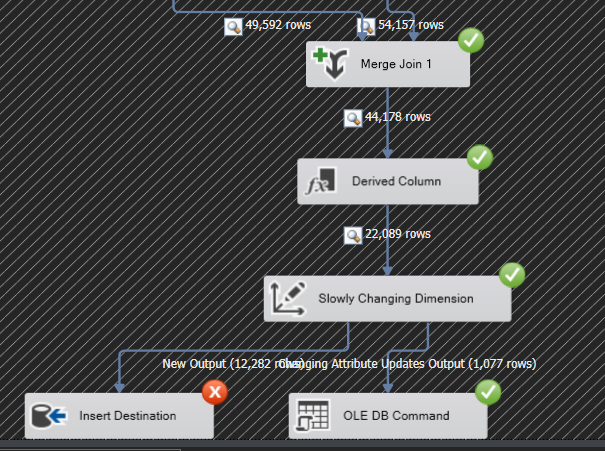

[Insert Destination [17]] Error: SSIS Error Code DTS_E_OLEDBERROR.  An OLE DB error has occurred. Error code: 0x80040E2F.
An OLE DB record is available.  Source: "Microsoft SQL Server Native Client 11.0"  Hresult: 0x80040E2F  Description: "The statement has been terminated.".
An OLE DB record is available.  Source: "Microsoft SQL Server Native Client 11.0"  Hresult: 0x80040E2F  Description: "Violation of PRIMARY KEY constraint 'pk_dim_customer'. Cannot insert duplicate key in object 'dbo.dim_customer'. The duplicate key value is (11642).".

[Insert Destination [17]] Error: SSIS Error Code DTS_E_INDUCEDTRANSFORMFAILUREONERROR.  The "Insert Destination.Inputs[OLE DB Destination Input]" failed because error code 0xC020907B occurred, and the error row disposition on "Insert Destination.Inputs[OLE DB Destination Input]" specifies failure on error. An error occurred on the specified object of the specified component.  There may be error messages posted before this with more information about the failure.

[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Insert Destination" (17) failed with error code 0xC0209029 while processing input "OLE DB Destination Input" (30). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.

[SSIS.Pipeline] Error: SSIS Error Code DTS_E_PROCESSINPUTFAILED.  The ProcessInput method on component "Merge Join 1" (355) failed with error code 0xC0047020 while processing input "Merge Join Left Input" (360). The identified component returned an error from the ProcessInput method. The error is specific to the component, but the error is fatal and will cause the Data Flow task to stop running.  There may be error messages posted before this with more information about the failure.


image.png

## After removing duplicated key, here is the outcome

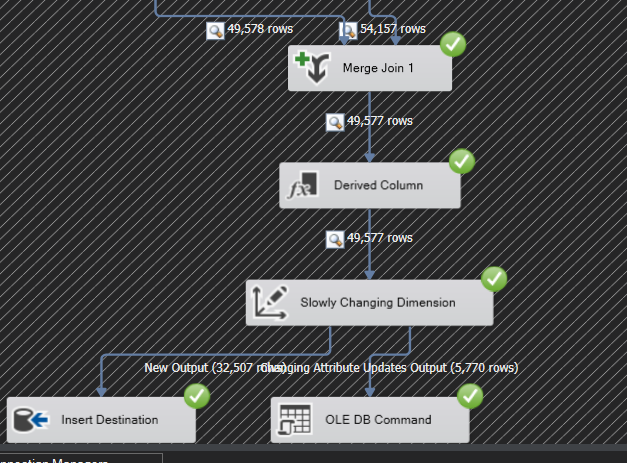


In [11]:
-- Checking customer count bwteen NDS and DDS
SELECT  'NDS Customer' AS 'table', COUNT(*) AS 'rows' from NDS.dbo.customer 
UNION ALL
SELECT 'DDS Customer', COUNT(*) FROM DDS.dbo.dim_customer

(2 rows affected)

Total execution time: 00:00:00.009

table,rows
NDS Customer,54158
DDS Customer,49577
